In [7]:
import torch
import torch.nn as nn
import numpy as np
import argparse
import os
from torch.autograd import Variable
from torchvision import datasets, transforms, models
import matplotlib
matplotlib.use('agg')
import matplotlib.pyplot as plt
from Baseline.model import ft_net
from PIL import Image
from tqdm import tqdm
import cv2 as cv
# from apex import amp

Import Data

In [8]:
import os
import numpy as np
from PIL import Image

target_root = os.path.join('University-Release', 'train', 'drone')
target_root2 = os.path.join('University-Release', 'train', 'satellite')

# print(os.listdir(os.path.join('University-Release', 'train')))
def pad(inp, pad = 3):
    #print(inp.size)
    h, w = inp.size
    bg = np.zeros((h+2*pad, w+2*pad, len(inp.mode)))
    bg[pad:pad+h, pad:pad+w, :] = inp
    return bg

count = 0
ncol = 20
nrow = 25
npad = 3
im = {}
image_labels = {}
image_labels['drone'] = []
image_labels['satellite'] = []
data = []
data_sat = []
white_col = np.ones( (128+2*npad,24,3))*255
for folder_name in os.listdir(target_root):
    image_labels['drone'].append(int(folder_name))
    folder_root = os.path.join(target_root, folder_name)
    if not os.path.isdir(folder_root):
        continue
    for img_name in os.listdir(folder_root):
        # print(os.path.join(folder_root, img_name))
        input1 = Image.open(os.path.join(folder_root, img_name))
        input1 = input1.convert('RGB')
        input1 = input1.resize( (128, 128))
        data.append(input1)
        # Start testing
        tmp = pad(input1, pad=npad)
        if count%ncol == 0:
            im[count//ncol] = tmp
        else:
            im[count//ncol] = np.concatenate((im[count//ncol], white_col, tmp), axis=1)
        count +=1
        if 'drone' in target_root:
            break

for folder_name in os.listdir(target_root2):
    image_labels['satellite'].append(int(folder_name))
    folder_root = os.path.join(target_root2, folder_name)
    if not os.path.isdir(folder_root):
        continue
    for img_name in os.listdir(folder_root):
        # print(os.path.join(folder_root, img_name))
        input1 = Image.open(os.path.join(folder_root, img_name))
        input1 = input1.convert('RGB')
        input1 = input1.resize( (128, 128))
        data_sat.append(input1)
        if 'satellite' in target_root:
            break
    # if count > nrow*ncol:
    #     break
data = np.array(data) 
data_sat = np.array(data_sat)
image_labels['drone'] = np.array(image_labels['drone'])
image_labels['satellite'] = np.array(image_labels['satellite'])

print(data.shape, data_sat.shape,image_labels['drone'].shape, image_labels['satellite'].shape)

(701,) (701,) (701,) (701,)


C:\Users\Iris\AppData\Local\Temp/ipykernel_7776/126762822.py:63: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  data = np.array(data)
C:\Users\Iris\AppData\Local\Temp/ipykernel_7776/126762822.py:63: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  data = np.array(data)
C:\Users\Iris\AppData\Local\Temp/ipykernel_7776/126762822.py:64: FutureWarning: The input object of type

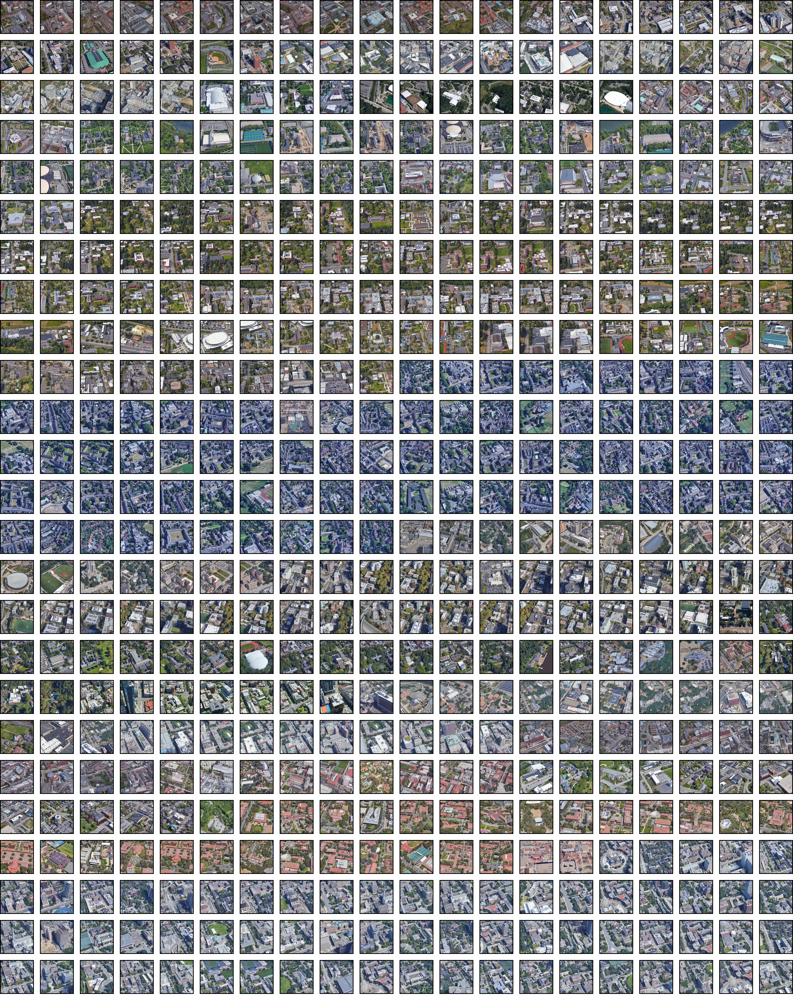

In [9]:
## Show Drone Data

first_row = np.ones((128+2*npad,128+2*npad,3))*255
white_row = np.ones( (24,im[0].shape[1],3))*255
for i in range(nrow):
    if i == 0:
        pic = im[0]
    else:
        pic = np.concatenate((pic, im[i]), axis=0)
    pic = np.concatenate((pic, white_row), axis=0)

pic2 = Image.fromarray(pic.astype('uint8'))
pic2.save('sample_%s.jpg'%os.path.basename(target_root))
pic2

In [10]:
# print(opt)
data_transforms = transforms.Compose([
        transforms.Resize((224, 224), interpolation=3),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

"""Can have different data transoformations for train and test data"""
# data_transforms = {
#     'train': transforms.Compose( data_transforms),
#     'test': transforms.Compose(data_transforms) }
# use_gpu = torch.cuda.is_available()

image_datasets = {}
image_datasets['drone'] = []
image_datasets['satellite'] = []
# for i in range(len(data)):
for i in range(50):
        image_datasets['drone'].append((data_transforms(data[i]), image_labels['drone'][i]))
        image_datasets['satellite'].append((data_transforms(data_sat[i]), image_labels['satellite'][i]))
        
# image_datasets['train_satellite'] = datasets.ImageFolder(os.path.join(data_dir, 'train', 'satellite'), data_transforms['train'])
# image_datasets['test'] = datasets.ImageFolder(os.path.join(data_dir, 'test', 'gallery_drone'), data_transforms['test'])

# image_datasets['val_drone'] = image_datasets['train_drone'].samples[300:]
# # image_datasets['val_satellite'] = image_datasets['train_satellite'].samples[30000:]

# image_datasets['train_drone'] = image_datasets['train_drone'].samples[:200]
# image_datasets['train_satellite'] = image_datasets['train_satellite'].samples[:200]

dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=8, shuffle=False, num_workers=8, pin_memory=True) # 8 workers may work faster
        for x in ['drone', 'satellite']}

# data_labels = {x: torch.utils.data.DataLoader(image_labels[x], batch_size=32, shuffle=False, num_workers=8, pin_memory=True) # 8 workers may work faster
#         for x in ['drone', 'satellite']}

dataset_sizes = {x: len(image_datasets[x]) for x in ['satellite', 'drone']}

C:\Users\Iris\AppData\Roaming\Python\Python38\site-packages\torchvision\transforms\transforms.py:287: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


In [11]:
num_epochs = 5
start_epoch = 0

running_loss = 0.0
running_corrects = 0.0
running_corrects2 = 0.0
running_corrects3 = 0.0

phase = 'train'
pred = 0

for j in range(num_epochs):
    # for data,data2 in zip(dataloaders['train_satellite'],dataloaders['train_drone']) :
    for data, data_sat in tqdm(zip(dataloaders['drone'], dataloaders['satellite'])):
        # get the inputs
        inputs_drone, labels_drone = data
        inputs_sat, labels_sat = data_sat
        # # now_batch_size,c,h,w = inputs.shape
        # # if now_batch_size<128: # skip the last batch
        # #     continue
        inputs = Variable(torch.as_tensor(inputs_drone))
        inputs2 = Variable(torch.as_tensor(inputs_sat))
        labels = Variable(torch.as_tensor(labels_drone))
        labels2 = Variable(torch.as_tensor(labels_sat))
            
        # model = ft_net(inputs)
        model = models.resnet50(pretrained=True)
        # zero the parameter gradients
        optimizer = torch.optim.Adam(model.parameters(), lr = 0.1)
        optimizer.zero_grad()

        if phase == 'val':
            with torch.no_grad():
                model = ft_net(inputs)
                outputs = model(inputs)
                
                model2 = ft_net(inputs2)
                outputs2 = model(inputs2)
        else:
            # model = ft_net(inputs)
            outputs = model(inputs)
            # model2 = ft_net(inputs2)
            outputs2 = model(inputs2)

        _,pred = torch.max(outputs, 1)
        _,pred2 = torch.max(outputs2,1)
        pred = torch.tensor(pred, dtype=float, requires_grad=True)
        pred2 = torch.tensor(pred2, dtype=float, requires_grad=True)
        
        # print(type(pred), type(pred2))

        loss_fn = nn.MSELoss()
        loss = loss_fn(pred.float(), labels.float()) + loss_fn(pred2.float(), labels2.float())
        loss = torch.tensor(loss, dtype=float, requires_grad=True)


        # loss = np.average((np.abs(torch.tensor(pred - labels)))**2)
        # loss = torch.tensor(loss)

        if phase == 'train':
            loss.backward()
            # with amp.scale_loss(loss, optimizer) as scaled_loss:
            #                     scaled_loss.backward()
            optimizer.step()

        # running_loss += (loss * 8)
    running_loss += loss
    running_corrects += float(torch.sum((pred - labels) < 150))
    running_corrects2 += float(torch.sum((pred2 - labels2) < 150))

    epoch_loss = float(running_loss) / (float(dataset_sizes['satellite'])*10)
    epoch_acc = float(running_corrects) / dataset_sizes['satellite']
    epoch_acc2 = float(running_corrects2) / dataset_sizes['drone']

    print(epoch_acc, epoch_acc2, epoch_loss)





0it [00:00, ?it/s]C:\Users\Iris\AppData\Local\Temp/ipykernel_7776/1866292928.py:47: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  pred = torch.tensor(pred, dtype=float, requires_grad=True)
C:\Users\Iris\AppData\Local\Temp/ipykernel_7776/1866292928.py:48: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  pred2 = torch.tensor(pred2, dtype=float, requires_grad=True)
C:\Users\Iris\AppData\Local\Temp/ipykernel_7776/1866292928.py:54: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  loss = torch.tensor(loss, dtype=float, requires_grad=True)
7it [02:09,

0.04 0.04 275.355


7it [00:56,  8.06s/it]


0.08 0.08 550.71


7it [00:25,  3.58s/it]


0.12 0.12 826.065


7it [00:16,  2.42s/it]


0.16 0.16 1101.42


7it [01:24, 12.02s/it]


0.2 0.2 1376.775


In [15]:
pred2

tensor([838., 541.], dtype=torch.float64, requires_grad=True)